# Music Information Retrieval, Project-A - Prototype 2 (#mirp-a2)

Similar to Prototype-1 with addition of:

## Example Relatedness Loss

- examples: input feats × target dims with confidence score [0,1] each
- relatedness: for each time frame for each example L2 norm of 1-distance
    - see phone for details


In [1]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import os

import numpy as np
import pandas as pd

import scipy
import librosa
import hsluv

import torch
from torch import nn 
from nnAudio import features 

import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (25,8)
%matplotlib inline
import seaborn as sb
sb.set(rc={'figure.figsize':(25,8)})
sb.set_style("whitegrid", {'axes.grid' : False, 
 'axes.spines.left': False,
 'axes.spines.bottom': False,
 'axes.spines.right': False,
 'axes.spines.top': False,});
noticks = dict(xticklabels=[], yticklabels=[])

from IPython.display import clear_output

#import my.feat

import os
import pathlib

import scipy.io.wavfile
import torch
import nnAudio

def get_specgram(audio_file, device='cpu', path='cache/specgram'):
    pathlib.Path(path).mkdir(parents=True, exist_ok=True)
    path = path+'/'+os.path.splitext(os.path.basename(audio_file))[0]+'.pt'

    if os.path.exists(path): return torch.load(path)

    rate, waveform = scipy.io.wavfile.read(audio_file) # Loading your audio

    waveform = waveform.mean(1) # converting stereo to mono
    waveform = torch.tensor(waveform, device=device).float() # casting the array into a PyTorch Tensor

    CQT = nnAudio.features.cqt.CQT(sr=rate)
    specgram = CQT(waveform)[0,:,:]
    specgram /= specgram.max()

    torch.save(specgram, path)
    return specgram


import scipy

def get_extrema(ys, dist=150, prom=0.3):
    return [scipy.signal.find_peaks(s*ys, distance=dist, prominence=prom)[0] for s in (-1, 1)]

127.17569160997732

<AxesSubplot:>

torch.Size([84, 10955])

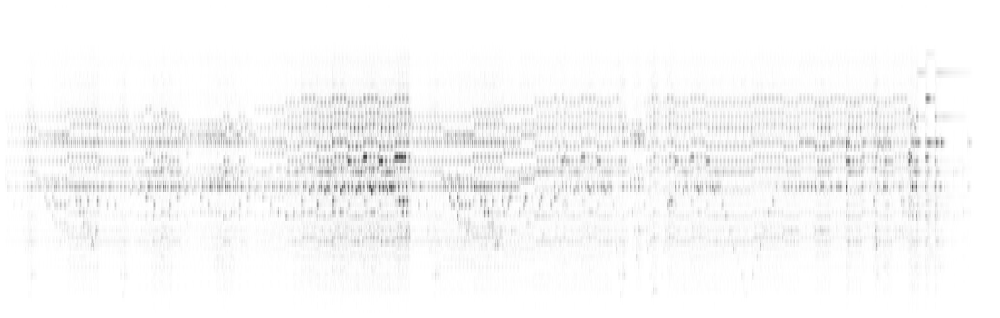

In [2]:
_audio_file = 'music/dancu.wav'

duration = librosa.get_duration(path=_audio_file)
duration

specgram = get_specgram(_audio_file)
sb.heatmap(specgram, cbar=False, **noticks, cmap='gray_r');
specgram.shape
frames = specgram.shape[1]

from IPython.display import Audio
Audio(_audio_file)

<AxesSubplot:>

<AxesSubplot:>

torch.Size([10955, 2])

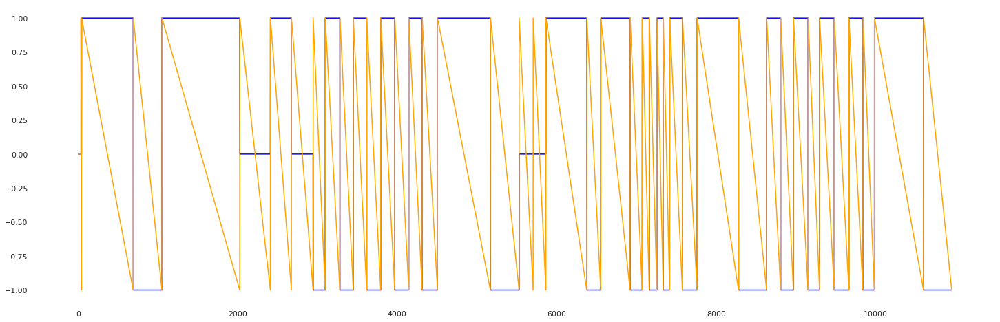

In [3]:
from chord_extractor.extractors import Chordino

# Setup Chordino with one of several parameters that can be passed
chordino = Chordino(roll_on=5)  #

chords = chordino.extract('music/dancu.wav')


# tonica = 1; dominant = -1; others = 0

import numpy as np

chord = np.zeros(frames)
decay = np.zeros(frames)  # relative position between two chord changes

for i,c in enumerate(chords):
    if   c.chord[0] in 'FD': v = 1
    elif c.chord[0] in 'C': v = -1
    else: v = 0

    t = min(frames,int(np.ceil(c.timestamp / duration * frames)))
    if i < len(chords)-1:
          t2 = min(frames,int(np.ceil(chords[i+1].timestamp / duration * frames)))
    else: t2 = frames

    chord[t:] = v
    decay[t:t2] = np.linspace(1,-1,t2-t)

sb.lineplot(x=np.arange(frames), y=chord, color='blue');
sb.lineplot(x=np.arange(frames), y=decay, color='orange');

input = torch.stack([torch.tensor(chord), torch.tensor(decay)], dim=1).float()
input.shape

In [4]:
def target_domain(hmin=0, hmax=360, mmin=-1, mmax=1):
    def mod2trg(h,l):
        h = (h-mmin)/(mmax-mmin)
        l = (l-mmin)/(mmax-mmin)
        return h * (hmax-hmin) + hmin, 100, l*100
        
    def trg2mod(H,L,S=100):
        H = (H-hmin)/(hmax-hmin)
        L /= 100
        return H * (mmax-mmin) + mmin, L * (mmax-mmin) + mmin

    return mod2trg, trg2mod

m2hsl, hl2m = target_domain(hmin=260, hmax=360)

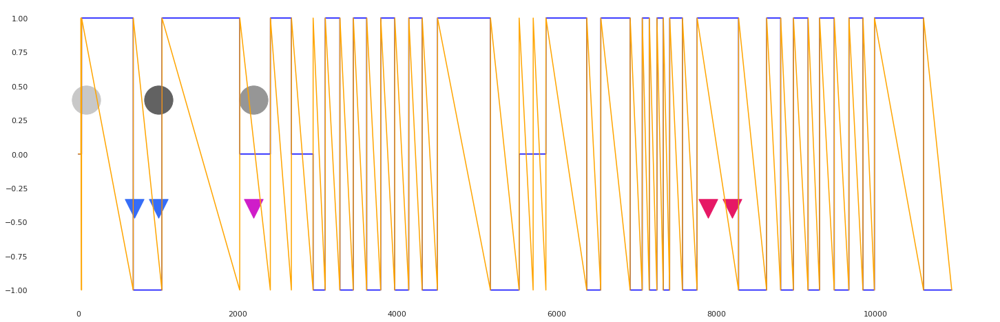

In [5]:
## programmatically annotate random points according to a simple function

# lists of examples which are (data-frame, target) where target [[values for all target dims ...], [confidences for all target values]]


def funs2examples(fns, indice=None, plot=True):
    if type(indice) is int:
        fii = [torch.tensor(np.random.choice(np.arange(frames), indice)) for fn in fns]  # get N random frame indices for each fn
    else: fii = [torch.tensor(ii) for ii in indice]

    fyy = [torch.stack([torch.tensor(fn(input[i])) for i in ii])
        for fn, ii in zip(fns, fii)]

    if plot:
        sb.lineplot(x=np.arange(frames), y=chord, color='blue');
        sb.lineplot(x=np.arange(frames), y=decay, color='orange');
        for f,m in zip(range(len(fns)), 'vosPX*.'):
            ii = fii[f]; yy = fyy[f]
            
            y_ = (f/(len(fns)-1+1e-9)*2-1)*0.4
            for x,y in zip(ii, yy):
                h,s,l = m2hsl(y[0,0], y[0,1])
                s *= y[1,0]
                plt.scatter(x,y_, c=hsluv.hsluv_to_hex([h,s,l]), s=(y[1,1]+0.75)*1000, marker=m);

    return torch.concatenate(fii), torch.concatenate(fyy)



#huefn = lambda f: [[((f[0]+1)/2)/(1-0.7)+0.7, 0.7], [0.95, 0]] 
huefn = lambda f: [[f[0],   0], [0.95, 0]] 
lumfn = lambda f: [[-0,  f[1]*.5+.2], [0, 0.95]] 

expos, extarg = funs2examples([huefn, lumfn], [[700,1000,2200,7900,8200], [100, 1000, 2200]])
#expos, extarg = funs2examples([huefn, lumfn], [[700,2200,7900], [100, 1000]])

In [6]:
extarg.shape
extarg[:,0,0].min(), extarg[:,0,0].max()
extarg[:,0,1].min(), extarg[:,0,1].max()

expos.shape

torch.Size([8, 2, 2])

(tensor(-1.), tensor(1.))

(tensor(-0.1663), tensor(0.6088))

torch.Size([8])

In [7]:
def relatednes(a,b):
    d = 1 - torch.abs(a-b)
    return (d**2).sum()**0.5


relates = torch.zeros((len(input), len(expos)))
for i,e in enumerate(expos):
    for j in range(len(input)):
        relates[j,i] = relatednes(input[i], input[e])

relates.shape

torch.Size([10955, 8])

example relatedness loss 

$$
\Mu_e(\Sigma_d[\Mu_p(|p_d - e_d| \cdot e^*_d \cdot (p_0\sim e_0))])
$$

- The mean $\Mu$ over all examples $e$ of 
    - The sum $\Sigma$ over all target dimensions $d$ of
        - The mean $\Mu$ over all predictions $p$ of
            - The absolute value $|p_d - e_d|$ of the difference between the prediction $p$ and the example $e$ for the target dimension $d$ multiplied by
            - The confidence score $e^*_d$ for the example $e$ for the target dimension $d$ multiplied by
            - The relatedness $p_0\sim e$ between the predictions $p$ input vector $p_0$ and the examples $e$ associated input vector $e_0$, which is the L2 norm of the 1-distance between the two vectors

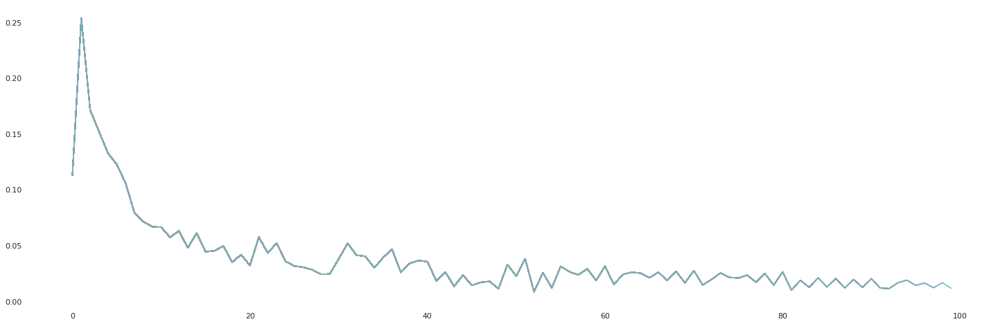

In [12]:
def LOSS(preds): 
    loss = 0
    
    for e in range(relates.shape[1]):
        for d in range(preds.shape[1]):
            t = expos[e]  ## NOTE  : instead of t would be example relatednesloss.. with t feedback is only fiven for target frames
            loss += (((preds[t,d] - extarg[e,0,d]).abs()*extarg[e,1,d]) * relates[t,e]).mean() 
                
    return loss / relates.shape[1]


D_input = input.shape[1]
D_target = 2
D_hidden = [5,5,5]

layers = [D_input, *D_hidden, D_target]
layers = list(zip(layers, layers[1:]))

model = nn.Sequential(
    *[nn.Sequential(
        nn.Linear(i,o),
        nn.Tanh(),
        nn.BatchNorm1d(o),
    ) for i,o in layers[:-1]],

    nn.Linear(*layers[-1]), 
)


optimizer = torch.optim.SGD(model.parameters(), lr=1e-1) 
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=40, gamma=0.8)  # for all other scenarios 20 was best

losses = []

def train():
    model.train()
    for e in range(Epochs):
        loss = LOSS(model(input))
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        scheduler.step()

        losses.append(loss.item())
        sb.lineplot(x=list(range(len(losses))), y=losses)


Epochs = 100

train();

model.eval();
with torch.no_grad(): target = model(input);

In [13]:
target[:,0].min(), target[:,0].max()
target[:,1].min(), target[:,1].max()

(tensor(-1.1301), tensor(1.1595))

(tensor(-0.5334), tensor(0.6935))

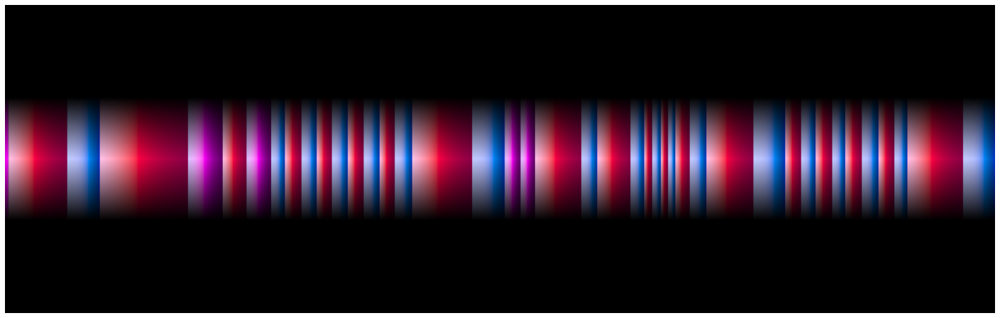

In [46]:
def render(Animation):
    out = np.zeros((5, Animation.shape[0], 3))
    for i, m in enumerate(Animation):
        out[2, i] = hsluv.hsluv_to_rgb(m2hsl(*m))
    plt.axis('off')
    return plt.imshow(out, aspect='auto', interpolation='bilinear')

render(target);

# Journal

## few points, loss only at keyframes

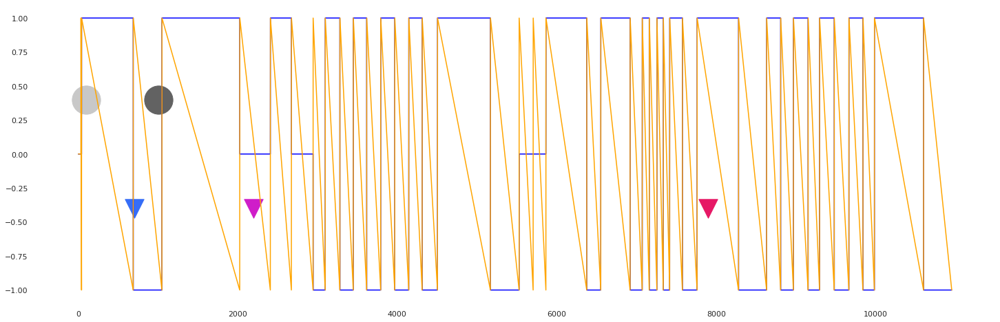
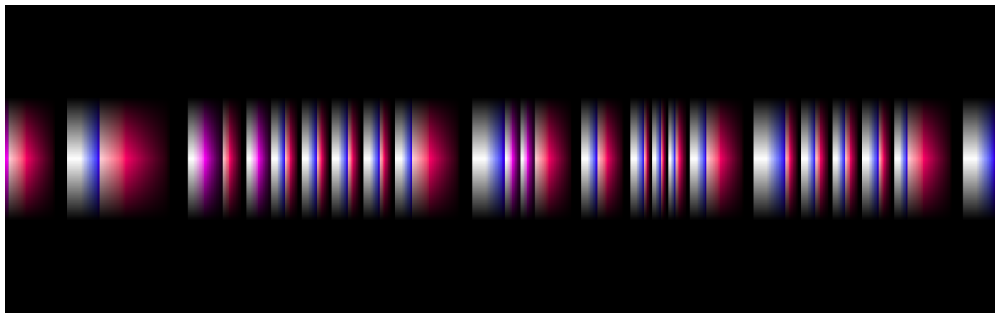
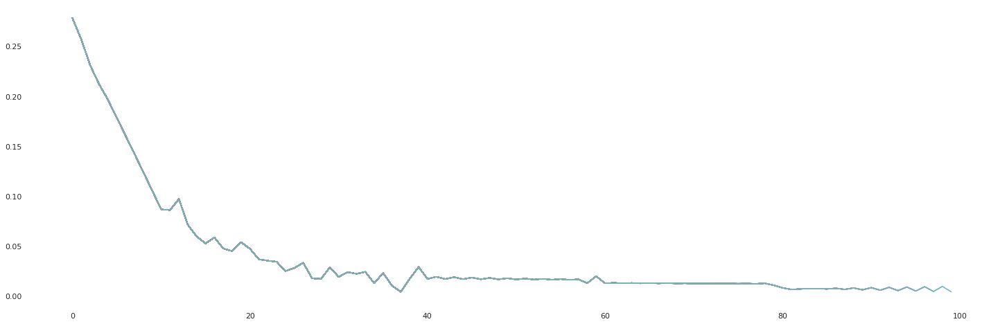

## more points, loss only at keyframes

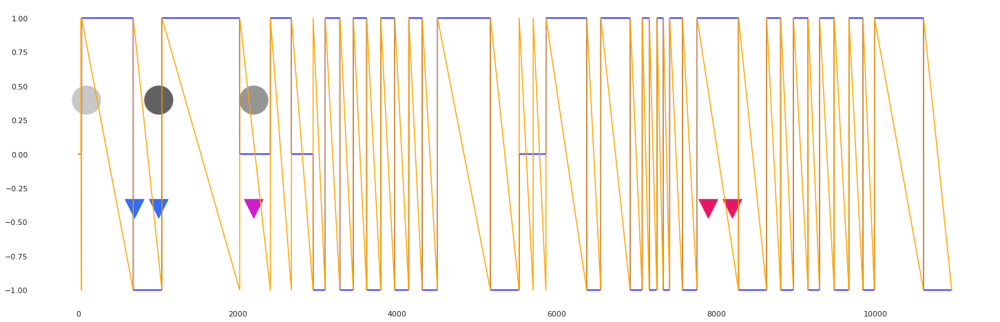
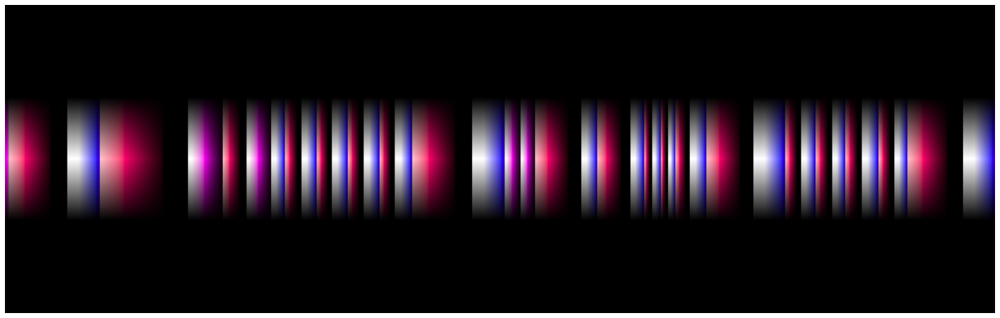
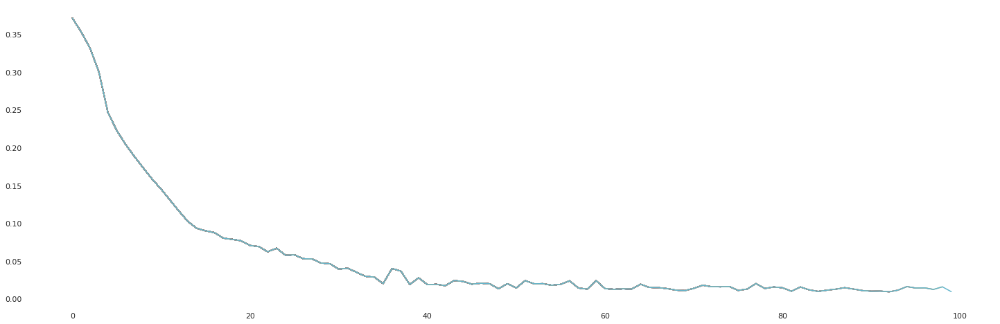

## few points global relatedness loss
(loss graph just looked good)

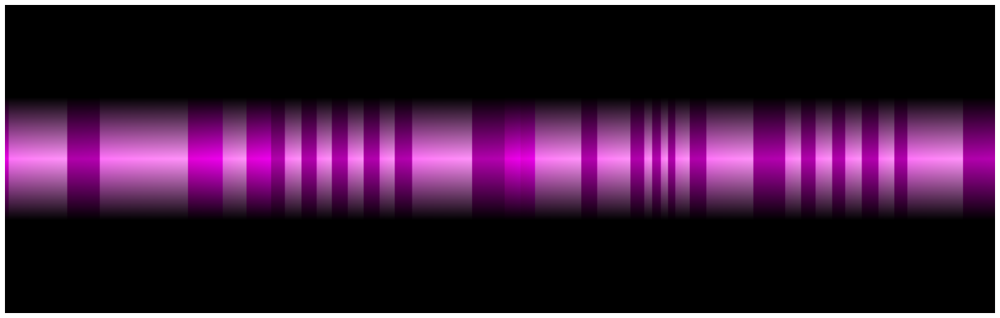

## more points global relatedness loss

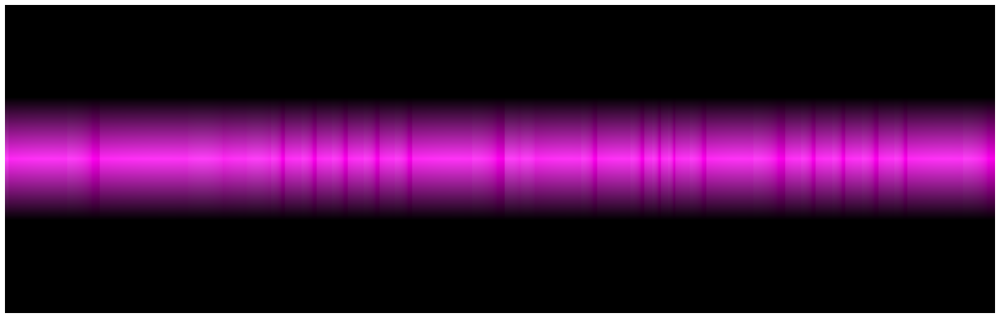

## just a single dimension with two points, global relatedness loss

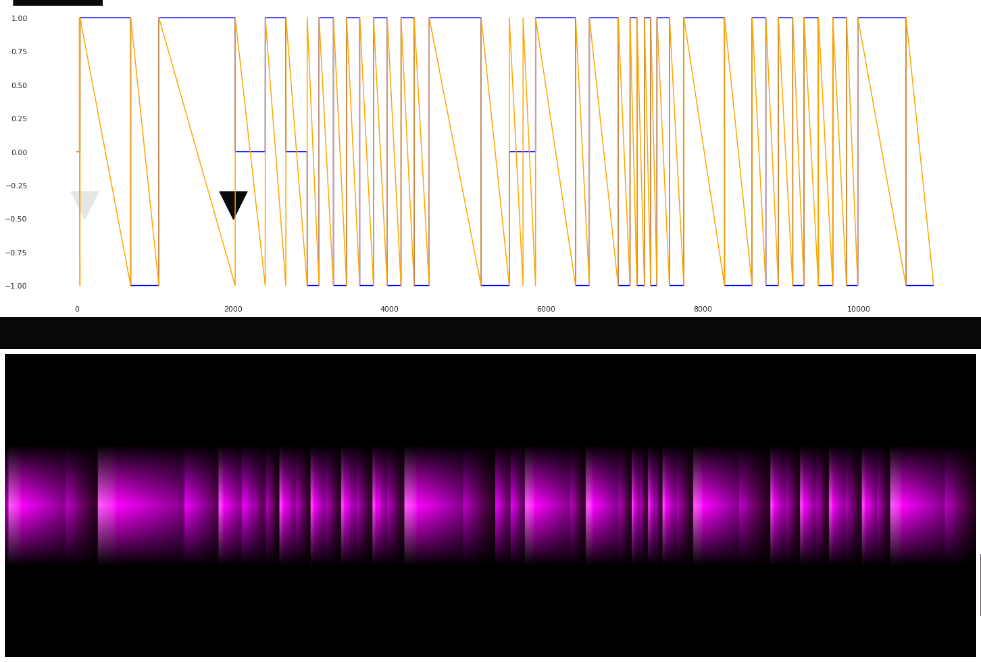

## more points, example relatedness loss and __deeper model__

Before model had 3 now 5,5,5 hidden layers. We see model complexity doesn't help deal with the relatedness loss.

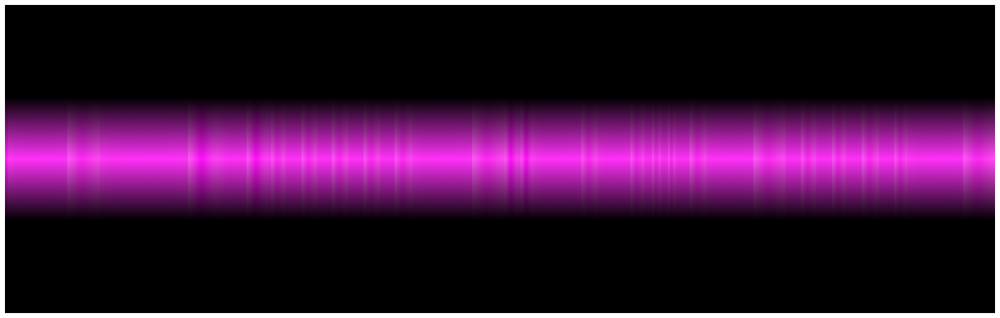
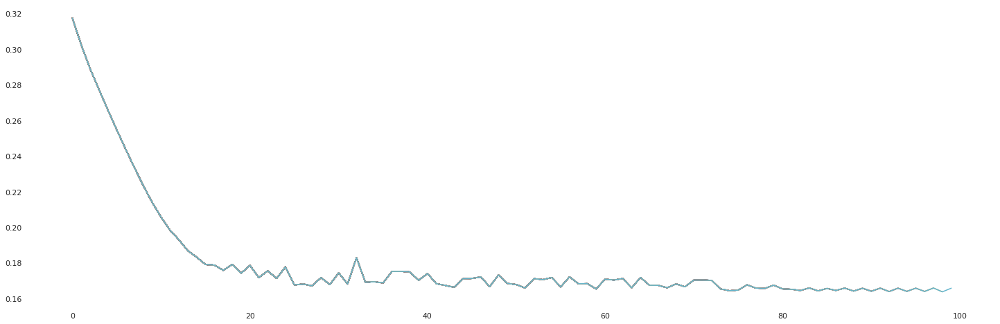

## more points, deeper model. but no global example relatednes loss

Uses the target space [-1,1]² more faithfully than the simpler model which oversteps the boundaries more and yields less smoothness and clipping. Saved this target for a visualization since it is the best.
`np.save('cache/target/hl.v2-more-555-noexloss', target)`

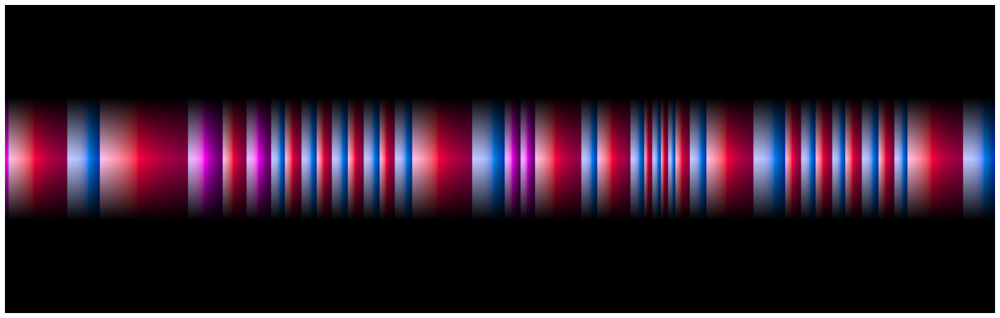
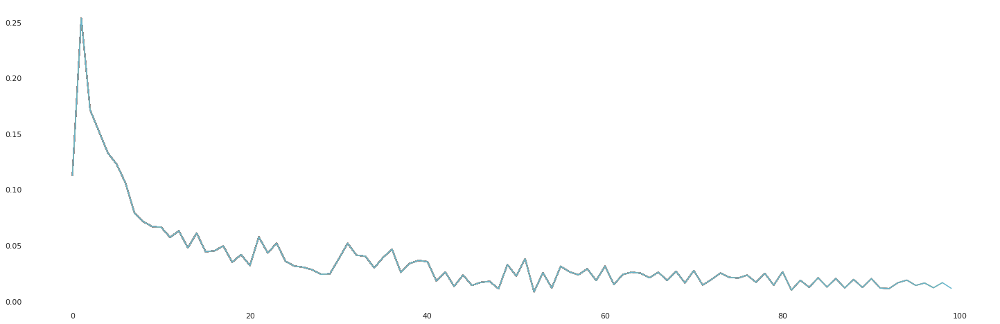


# Discussion

The global relatednes loss does not work especially with more points.
This comes from the fact that there is just to much gradient traction from opposite examples since the majority of datapoints lies between those. When they all get combined they level out and the model converges towards a mean.

Providing gradient feedback only at the example frames converges nicely. This is because the simple identity relationship between the two input feature dimensions and the two target dimensions. This can break in more complex scenarios - even when the latents are disentangled, the annotations might not correlate one to one. Though just slightly more examples should work.

In this case (assuming direct correlations of feature and target dims) a neural network is even superflous and a more simple regression would suffice.

In fact whenever the input representation is of high quality and disentagled, a linear regression to each target dimension should be sufficient. The only reason to use a neural network is to learn a more complex mapping from the input to the target dimensions. This is especially true when the input representation is not disentangled and the target dimensions are not directly correlated to the input dimensions.

## Compound Constrains
Compound constrains express interdependence of target params. Like: there should never be blue and yellow at the same time or all lights must move usually similar.
It is important to note that exceptions from compound constraints must be carefully weighted because c.c. apply to most frames and exceptions only to exceptions..

A neural network is appropriate to learn compound constrains aka interdependence of outputs.

## Aligning two spaces using general faithfull alignment losses and orientation provided by examples

- Is there a general loss to faithfully align two (latent) spaces? Example points fix degrees of freedom for the mapping. The mapping must also deform non-linearly to fit the example points. 


# Rendering a Music Video

In [80]:
%%capture

! mkdir -p cache/framebuff

def render_frames(target):
    for i,m in enumerate(target):
        out = np.zeros((5, 5, 3))
        out[2,2] = hsluv.hsluv_to_rgb(m2hsl(*m))
        fig = plt.figure(figsize = (1,1))
        fig.patch.set_facecolor('black')

        plt.axis('off')
        plt.imshow(out, aspect='equal', interpolation='sinc', interpolation_stage='rgba');
        plt.savefig(f'cache/framebuff/{i:05d}', dpi=32)
    
frames = target[::5]
render_frames(frames)

In [82]:

! mkdir -p render
! rm render/dancu-v2.mp4 
# see https://stackoverflow.com/questions/14782077/expand-extend-a-video-to-an-specific-duration
! ffmpeg -i cache/framebuff/%05d.png -i {_audio_file} -filter_complex "[0:v]setpts=PTS*{duration}/{len(frames)/(FPS:=25)}[v]" -map "[v]" -map 1:a -shortest render/dancu-v2.mp4 

#! rm -r cache/framebuff

rm: das Entfernen von 'output.mp4' ist nicht möglich: Datei oder Verzeichnis nicht gefunden
ffmpeg version n6.0 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 12.2.1 (GCC) 20230201
  configuration: --prefix=/usr --disable-debug --disable-static --disable-stripping --enable-amf --enable-avisynth --enable-cuda-llvm --enable-lto --enable-fontconfig --enable-gmp --enable-gnutls --enable-gpl --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libdav1d --enable-libdrm --enable-libfreetype --enable-libfribidi --enable-libgsm --enable-libiec61883 --enable-libjack --enable-libjxl --enable-libmfx --enable-libmodplug --enable-libmp3lame --enable-libopencore_amrnb --enable-libopencore_amrwb --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librav1e --enable-librsvg --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtheora --enable-libv4l2 --enable-libvidstab --